## Подготовка

Установим нужные библиотечки

In [ ]:
!pip install pytorch_tabular
!pip install tf-estimator-nightly==2.8.0.dev2021122109
!pip install imgaug==0.2.6
!pip install pytorch-lightning==1.3.6
!pip install torchmetrics==0.3.2
!pip install torch==1.8.0+cu111 torchvision==0.9.0+cu111 torchaudio==0.8.0 -f https://download.pytorch.org/whl/torch_stable.html
!pip install torchtext==0.9.0
!pip install omegaconf==2.1.2

     |████████████████████████████████| 2.0 MB 8.5 MB/s 
     |████████████████████████████████| 80 kB 11.8 MB/s 
     |████████████████████████████████| 9.5 MB 44.6 MB/s 
     |████████████████████████████████| 809 kB 53.9 MB/s 
     |████████████████████████████████| 78 kB 9.8 MB/s 
     |████████████████████████████████| 409 kB 59.8 MB/s 
     |████████████████████████████████| 596 kB 67.7 MB/s 
     |████████████████████████████████| 636 kB 69.0 MB/s 
     |████████████████████████████████| 140 kB 77.7 MB/s 
     |████████████████████████████████| 829 kB 62.8 MB/s 
     |████████████████████████████████| 1.1 MB 30.4 MB/s 
     |████████████████████████████████| 117 kB 59.7 MB/s 
     |████████████████████████████████| 94 kB 4.2 MB/s 
     |████████████████████████████████| 271 kB 66.3 MB/s 
     |████████████████████████████████| 144 kB 51.0 MB/s 
  Created wheel for pytorch-tabular: filename=pytorch_tabular-0.7.0-py2.py3-none-any.whl size=83790 sha256=2d76e06db49f10b1ad2b5adf6e50d

     |████████████████████████████████| 462 kB 5.7 MB/s 
     |████████████████████████████████| 631 kB 7.5 MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-py3-none-any.whl size=654017 sha256=65e0aca82631ca757d3ac5e699823afc48ad730cea4cd281a25b018b6e71a81d
  Stored in directory: /root/.cache/pip/wheels/89/72/98/3ebfdba1069a9a8eaaa7ae7265cfd67d63ef0197aaee2e5f9c
Successfully built imgaug
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
     |████████████████████████████████| 274 kB 7.1 MB/s 
  Attempting uninstall: torchmetrics
    Found existing installation: torchmetrics 0.8.2
    Uninstalling torchmetrics-0.8.2:
      Successfully uninstalled torchmetrics-0.8.2
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |█████████████▌                  | 834.1 MB 1.2 MB/s eta 0:15:20tcmalloc: large alloc 1147494400 bytes == 0x3a41e000 @  0x7f7cc94d3615 0x592b76

In [ ]:
import sys
!{sys.executable} -m pip install numpy pandas catboost scikit-learn scikit-multilearn

     |████████████████████████████████| 76.6 MB 78 kB/s 
     |████████████████████████████████| 89 kB 9.9 MB/s 


Импортируем их

In [ ]:
import random
from torch.nn.functional import binary_cross_entropy
import numpy as np
import pandas as pd
import catboost as cb
import seaborn as sns
import sklearn.utils as sku
from skmultilearn.model_selection import iterative_train_test_split
from sklearn.model_selection import KFold
import os
import json
import lightgbm
import xgboost as xgb
from sklearn.metrics import fbeta_score, classification_report
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV, LinearRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder
from sklearn.pipeline import make_pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestClassifier
from sklearn.multioutput import MultiOutputClassifier
from sklearn.datasets import make_multilabel_classification
from sklearn.ensemble import StackingClassifier
from sklearn.tree import DecisionTreeClassifier
from matplotlib import pyplot as plt
from torch import optim
import seaborn
import torch
from fastai.tabular import *
from IPython.display import clear_output
from google.colab import drive
drive.mount('/content/drive')
!unzip -q /content/drive/MyDrive/ColabNotebooks/AI_Challenge/data.zip

Mounted at /content/drive


Зафиксируем random seed

In [ ]:
SEED = 42

random.seed(SEED)
np.random.seed(SEED)

Укажем пути до файлов

In [ ]:
PAYMENTS_TRAIN_PATH = 'data/payments_train.csv'
TARGET_TRAIN_PATH = 'data/target_train.csv'
PAYMENTS_TEST_PATH = 'data/payments_test.csv'
CLIENT_ID_TEST_PATH = 'data/client_id_test.csv'

In [ ]:
device = 'cpu'
use_cuda = True
if use_cuda and torch.cuda.is_available():
    device = 'cuda:0'
    print(f'Now device = {device}')

Now device = cuda:0


## Загружаем датасет

In [ ]:
payments_dtypes = {
    'client_id': str,
    'contractor_id': str,
    'is_outgoing': bool,
    'amount': 'uint64',
    'dt_day': 'uint16',
    'dt_hour': 'uint8',
    'channel': pd.CategoricalDtype()
}
for i in range(12):
    payments_dtypes[f'flag_{i}'] = bool
payments_dtypes

{'amount': 'uint64',
 'channel': CategoricalDtype(categories=None, ordered=False),
 'client_id': str,
 'contractor_id': str,
 'dt_day': 'uint16',
 'dt_hour': 'uint8',
 'flag_0': bool,
 'flag_1': bool,
 'flag_10': bool,
 'flag_11': bool,
 'flag_2': bool,
 'flag_3': bool,
 'flag_4': bool,
 'flag_5': bool,
 'flag_6': bool,
 'flag_7': bool,
 'flag_8': bool,
 'flag_9': bool,
 'is_outgoing': bool}

In [ ]:
payments = pd.read_csv(PAYMENTS_TRAIN_PATH, dtype=payments_dtypes)
payments

,client_id,contractor_id,is_outgoing,amount,dt_day,dt_hour,channel,flag_0,flag_1,flag_2,flag_3,flag_4,flag_5,flag_6,flag_7,flag_8,flag_9,flag_10,flag_11
0,569703,NaN,True,8674442,56,12,app,False,False,False,False,False,False,False,False,False,False,False,False
1,696595,3920,True,5714350,311,19,web,False,False,False,False,False,False,False,False,False,False,False,False
2,368467,NaN,True,3720501,175,13,NaN,False,False,False,True,False,False,False,False,False,False,False,False
3,421133,NaN,True,311542,68,14,NaN,False,False,False,True,False,False,False,False,False,False,False,False
4,365044,24686,True,705918747,171,15,app,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25937985,532940,NaN,True,904019,122,1,pos,True,False,False,False,False,False,False,False,False,False,False,False
25937986,923040,NaN,False,27261705,94,12,NaN,False,False,False,False,False,False,False,False,False,False,False,True
25937987,807703,58960,False,18409310,119,13,NaN,False,False,False,False,False,False,False,False,False,False,False,True
25937988,890561,NaN,True,7132,213,8,NaN,False,False,False,True,False,False,False,False,False,False,False,False


In [ ]:
target_dtypes = {
    'client_id': str
}
for i in range(35):
    target_dtypes[f'type_{i}'] = int

In [ ]:
target = pd.read_csv(TARGET_TRAIN_PATH, dtype=target_dtypes).set_index('client_id')
target

,type_0,type_1,type_2,type_3,type_4,type_5,type_6,type_7,type_8,type_9,...,type_25,type_26,type_27,type_28,type_29,type_30,type_31,type_32,type_33,type_34
client_id,,,,,,,,,,,,,,,,,,,,,
775943,1,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
992314,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
255821,1,0,0,0,0,0,0,0,0,1,...,1,0,0,0,0,1,0,0,1,0
188791,0,0,1,0,0,0,0,0,0,1,...,1,0,0,0,0,0,1,0,0,0
46092,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20306,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
406742,1,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,1,0,0,0,0
242611,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


##Анализ датасета

In [ ]:
payments.isna().sum()/payments.shape[0]

client_id        0.000000
contractor_id    0.558223
is_outgoing      0.000000
amount           0.000000
dt_day           0.000000
dt_hour          0.000000
channel          0.452877
flag_0           0.000000
flag_1           0.000000
flag_2           0.000000
flag_3           0.000000
flag_4           0.000000
flag_5           0.000000
flag_6           0.000000
flag_7           0.000000
flag_8           0.000000
flag_9           0.000000
flag_10          0.000000
flag_11          0.000000
dtype: float64

шок, 55% контрагентов пропуски и 45% каналов также пропуски. радует, что остальные данные без пропусков

In [ ]:
payments.channel.value_counts(dropna=False, normalize=True)

NaN    0.452877
pos    0.270718
web    0.155199
app    0.076721
atm    0.044485
Name: channel, dtype: float64

In [ ]:
payments.nunique()

client_id           67005
contractor_id      811473
is_outgoing             2
amount           15926312
dt_day                366
dt_hour                24
channel                 4
flag_0                  2
flag_1                  2
flag_2                  2
flag_3                  2
flag_4                  2
flag_5                  2
flag_6                  2
flag_7                  2
flag_8                  2
flag_9                  2
flag_10                 2
flag_11                 2
dtype: int64

обратим внимание на контрагентов: их больше чем самих клиентов, значит операции не замкнуты относительно клиентов

In [ ]:
payments.describe(include=object)

,client_id,contractor_id
count,25937990,11458818
unique,67005,811473
top,750738,471487
freq,2017,190396


присмотримся потом к 750738 и 471487

In [ ]:
payments.describe(include=pd.CategoricalDtype())

,channel
count,14191277
unique,4
top,pos
freq,7021875


In [ ]:
payments.describe()

,amount,dt_day,dt_hour
count,2.593799e+07,2.593799e+07,2.593799e+07
mean,1.106642e+08,1.917310e+02,8.948613e+00
std,1.597724e+09,1.093326e+02,6.244695e+00
min,1.000000e+00,0.000000e+00,0.000000e+00
25%,9.465660e+05,9.600000e+01,3.000000e+00
50%,5.694286e+06,1.970000e+02,9.000000e+00
75%,3.415061e+07,2.910000e+02,1.400000e+01
max,2.455193e+12,3.650000e+02,2.300000e+01


50% всех транзакций до 9 утра, 75% - до обеда

In [ ]:
(payments.client_id=='750738').sum(), (payments.contractor_id=='471487').sum()

(2017, 190396)

довольно странно, что клиенту 471487 так много переводов, проверим есть ли он среди клиентов и какие переводы у него

In [ ]:
(payments.client_id=='471487').sum()

0

его нет среди клиентов. какой-то сторонний адрес, на который переводится очень много денег

In [ ]:
(payments.loc[payments.contractor_id=='471487', 'amount']).sum(), (payments.loc[payments.contractor_id=='471487', 'amount']).sum()/payments.amount.sum()

(13325356089482, 0.004642321778873446)

0.46% всех транзакций с этим адресом

In [ ]:
(payments.loc[payments.contractor_id=='471487', 'is_outgoing']).sum()

3222

сам адрес послал только 3222 транзакций, на него пришло гораздо больше

###Микро-итоги

1)не можем убрать NaN, тк они занимают существенную часть данных
2)есть некоторые интересные адреса, через которые проходит очень много денег

##Гипотезы



*   все контрагенты не являются клиентами
*   большая часть транзакций совершается утром (до обеда) и большее количество денег переводится также утром (до обеда)
*   сумма транзакции зависит от выбора платформы



##Графики

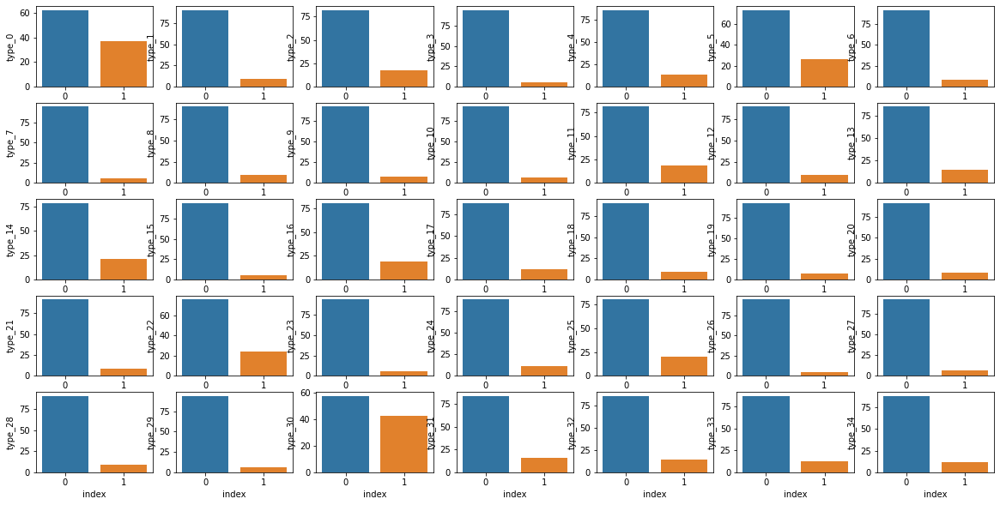

In [ ]:
fig, axes = plt.subplots(5, 7, figsize=(20, 10))
axes=axes.ravel()
for i in range(35):
  norm_target = (target
                [f'type_{i}']
                .value_counts(normalize=True)
                .mul(100)
                .reset_index())
  sns.barplot(x='index', y=f'type_{i}', data=norm_target, ax=axes[i])
plt.show()

Видим, что большинство таргетных type распределены неравномерно, и отсутствие признака гораздо чаще встречается (оно и понятно). Но есть признаки (type_0, type_30), которые встречаются примерно так же, как и их отсутствие.

посмотрим на контрагентов - клиентов

In [ ]:
payments[payments.contractor_id==payments.client_id].client_id.count()/payments.shape[0]

0.10752556385440815

In [ ]:
payments[payments.contractor_id==payments.client_id]

,client_id,contractor_id,is_outgoing,amount,dt_day,dt_hour,channel,flag_0,flag_1,flag_2,flag_3,flag_4,flag_5,flag_6,flag_7,flag_8,flag_9,flag_10,flag_11
7,868837,868837,True,376372679,137,14,NaN,False,False,False,False,False,False,False,False,False,False,False,False
14,249366,249366,True,98798,331,1,NaN,False,False,False,False,False,False,False,False,False,False,False,False
17,880791,880791,True,25352751,274,16,NaN,False,False,False,False,False,False,False,False,False,False,False,False
19,518564,518564,True,245087,49,8,NaN,False,False,False,False,False,False,False,False,False,False,False,False
23,260965,260965,True,48752667,246,8,NaN,False,True,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25937920,810446,810446,False,13264769,102,3,NaN,False,False,False,False,False,False,False,False,False,False,False,True
25937926,858331,858331,False,53014460,134,5,NaN,False,False,False,False,False,False,False,False,False,False,False,True
25937947,342439,342439,False,28370578,150,21,NaN,False,False,False,False,False,False,False,False,False,False,False,False
25937949,863658,863658,True,160753195,37,16,NaN,False,True,False,False,False,False,False,False,False,False,False,False


In [ ]:
payments[payments.contractor_id==payments.client_id].is_outgoing = True

/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


как-то слишком много NaN в графе channel

In [ ]:
payments[payments.contractor_id==payments.client_id].channel.value_counts(dropna=False)

NaN    2621979
app     115855
web      51163
pos          0
atm          0
Name: channel, dtype: int64

Это интересная закономерность. atm и pos не участвуют в транзакциях, где отправитель и получатель это одно и то же лицо. Также в большинстве случаев, канал передачи нам неизвестен.

Давайте посмотрим на распределение сумм транзакций от канала

## Feature Engineering

Сгенерируем следующие фичи:
* Статистика сумм транзакций по клиентам
* Количество транзакций с флагами с 0 по 11 по клиентам
* Среднее количество флагов у клиента
* Статистика количества использований каждого канала по клиентам
* Среднее и медиана по часам транзакций
* Среднее и медиана по дням транзакций
* Количество транзакций по клиентам

Обернём весь feature engineering в функцию, чтобы потом переиспользовать её для генерации фичей для тестовой выборки

In [ ]:
def generate_features(pay):
  # раздампим колонку каналов на one-hot-encoding
    pay = pd.get_dummies(pay, columns=['channel'], drop_first=False, dummy_na=True)
  # создадим колонку, показывающую сколько в среднем флагов в транзакции  
    pay['how_many_flags'] = pay[[f'flag_{i}' for i in range(12)]].sum(axis=1)
  # логарифмируем колонку amount, тк разброс слишком сильный
    pay['amount'] = np.log(pay['amount'])
    fts = pay.groupby('client_id')['amount'].agg(['mean', 'median', 'std', 'min', 'max'])
    fts['count_transactions'] = pay.groupby('client_id')['flag_0'].count()
    fts[['dt_hour_mean', 'dt_hour_median']] = pay.groupby('client_id')['dt_hour'].agg(['mean', 'median'])
    fts[['dt_day_mean', 'dt_day_median']] = pay.groupby('client_id')['dt_day'].agg(['mean', 'median'])
    fts['how_many_flags_average'] = pay.groupby('client_id')['how_many_flags'].agg('mean')
    fts[['channel_app',	'channel_atm', 'channel_pos',	'channel_web', 'channel_nan']] =\
     pay.groupby('client_id')[['channel_app',	'channel_atm', 'channel_pos',	'channel_web', 'channel_nan']].sum()
    fts[[f'flag_{i}_count' for i in range(12)]] = pay.groupby('client_id')[[f'flag_{i}' for i in range(12)]].sum()
    return fts

In [ ]:
features = generate_features(payments)

In [ ]:
features

,mean,median,std,min,max,count_transactions,dt_hour_mean,dt_hour_median,dt_day_mean,dt_day_median,...,flag_2_count,flag_3_count,flag_4_count,flag_5_count,flag_6_count,flag_7_count,flag_8_count,flag_9_count,flag_10_count,flag_11_count
client_id,,,,,,,,,,,,,,,,,,,,,
100045,14.434006,14.349937,2.031639,3.091042,18.641723,477,8.597484,8.0,214.935010,262.0,...,60,47,5,0,0,0,5,0,0,0
100055,15.126989,15.204432,2.074503,7.713338,20.456851,651,10.657450,12.0,185.319508,185.0,...,42,151,68,0,0,0,71,0,0,0
100068,15.438791,14.988645,2.185357,10.435380,20.340493,519,5.645472,3.0,280.612717,281.0,...,22,8,18,0,0,0,19,0,0,0
100076,14.227020,14.235649,2.274270,3.367296,19.360160,93,7.043011,4.0,63.086022,61.0,...,11,8,10,0,0,0,10,0,0,0
100089,16.543075,16.906459,1.383156,7.325808,20.285159,1584,13.543561,14.0,206.648359,233.0,...,52,112,5,0,0,0,6,0,0,923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99975,14.304114,14.100525,3.006638,8.446771,20.571929,50,11.860000,13.0,86.440000,72.0,...,1,19,5,0,0,0,5,0,0,0
999759,14.897531,14.197973,2.452812,8.464214,22.612203,273,6.457875,3.0,203.959707,224.0,...,0,13,3,0,0,0,4,0,0,0
999784,16.687592,16.736141,3.502947,10.260952,22.002619,85,8.929412,8.0,151.694118,148.0,...,0,24,12,0,0,0,12,8,0,0


## Разбиение датасета на train / val

Реализуем функцию для разбиения датасета на обучающую и валидационную выборки в пропорциях 85%/15% соответвенно, примерно сохраняя распределение таргетов в обеих выборках. Из соображений быстродействия и детерминированности будем кешировать разбиение в JSON-файл. 

Для стратификации используется функция [iterative_train_test_split](http://scikit.ml/_modules/skmultilearn/model_selection/iterative_stratification.html#iterative_train_test_split) из библиотечки scikit-multilearn.

In [ ]:
def stratified_split_cached(X, y, split_idx_file):
    if os.path.isfile(split_idx_file):
        with open(split_idx_file, 'r') as f:
            split_json = json.load(f)
        train_idx, val_idx = split_json['train'], split_json['val']
    else:
        y_shuffle = sku.shuffle(y, random_state=SEED)  # https://cpb-us-e1.wpmucdn.com/journeys.dartmouth.edu/dist/8/830/files/2020/06/EIqwWwsX0AAeh-o.jpeg
        train_idx, _, val_idx, _ = iterative_train_test_split(np.expand_dims(y_shuffle.index, 1), np.array(y_shuffle), test_size=0.15)
        train_idx, val_idx = train_idx.squeeze(1), val_idx.squeeze(1)
        with open(split_idx_file, 'w') as f:
            json.dump({'train': list(train_idx), 'val': list(val_idx)}, f)
    return X.loc[train_idx], y.loc[train_idx], X.loc[val_idx], y.loc[val_idx]

In [ ]:
X_train, y_train, X_val, y_val = stratified_split_cached(features, target, 'split_cache.json')

In [ ]:
len(X_train), len(y_train), len(X_val), len(y_val)

(57152, 57152, 9853, 9853)

Загрузим тестовые данные

In [ ]:
payments_test = pd.read_csv(PAYMENTS_TEST_PATH, dtype=payments_dtypes)
payments_test

,client_id,contractor_id,is_outgoing,amount,dt_day,dt_hour,channel,flag_0,flag_1,flag_2,flag_3,flag_4,flag_5,flag_6,flag_7,flag_8,flag_9,flag_10,flag_11
0,303546,NaN,True,378449,50,2,NaN,False,False,False,True,False,False,False,False,False,False,False,False
1,59719,NaN,True,281527,267,2,pos,True,False,False,False,False,False,False,False,False,False,False,False
2,25428,90165,False,2105146744,294,9,NaN,False,False,False,False,False,False,False,False,False,False,False,False
3,766314,NaN,True,2156082,207,14,pos,True,False,False,False,False,False,False,False,False,False,False,False
4,465049,NaN,True,51694546,211,3,atm,True,False,True,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8553957,794745,773056,False,858062290,198,16,NaN,False,False,False,False,False,False,False,False,False,False,False,False
8553958,362168,904134,False,8540123,130,13,NaN,False,False,False,False,False,False,False,False,False,False,False,False
8553959,500006,471487,False,65346645,196,12,NaN,False,False,False,False,False,False,False,False,False,False,False,False
8553960,653741,NaN,True,3296030,43,0,NaN,True,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
X_test = generate_features(payments_test)
X_test

,mean,median,std,min,max,count_transactions,dt_hour_mean,dt_hour_median,dt_day_mean,dt_day_median,...,flag_2_count,flag_3_count,flag_4_count,flag_5_count,flag_6_count,flag_7_count,flag_8_count,flag_9_count,flag_10_count,flag_11_count
client_id,,,,,,,,,,,,,,,,,,,,,
100050,14.777094,15.384174,3.118904,6.682109,19.977986,160,12.725000,14.0,190.000000,213.0,...,0,35,13,0,0,0,13,0,0,0
100128,17.197976,17.566759,2.644109,7.783641,22.173294,97,14.340206,14.0,163.237113,123.0,...,0,19,11,0,0,0,11,24,0,0
100159,18.095510,18.196237,1.456712,9.776506,21.022269,746,11.292225,11.0,170.028150,161.0,...,0,11,52,0,0,0,53,0,0,0
10018,16.941447,17.094196,1.598901,3.761200,20.510407,350,13.945714,15.0,81.920000,56.5,...,0,17,13,0,0,0,14,0,0,0
100237,16.686368,17.740937,3.408560,10.358092,21.648241,106,11.915094,13.0,239.830189,240.5,...,12,28,2,0,0,0,2,7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999572,16.648117,16.884937,1.750603,7.667158,21.184685,770,13.524675,14.0,185.229870,186.0,...,0,22,76,0,0,0,80,0,3,0
99966,14.355755,13.764335,2.322074,6.359574,21.796356,858,4.870629,3.0,197.534965,222.0,...,14,17,26,0,0,0,26,0,5,5
999662,15.382964,15.436898,2.095205,9.883591,20.668908,400,8.170000,4.5,127.247500,111.5,...,20,8,20,0,0,0,21,0,0,0


In [ ]:
test_ind = X_test.index.tolist()
train_ind = X_train.index.tolist()
val_ind = X_val.index.tolist()

## Моделлинг

Функция для создания Pool из двух датафреймов

In [ ]:
def make_pool(X, y=None):
    return cb.Pool(X, y)

Обучение набора моделей

In [ ]:
def lgb_train(X_train, y_train, X_val, y_val, X_test, multiclass=False):
    params_lgb = {
          'objective': 'binary',
          'metric': 'rmse',
          'num_leaves': 49,
          'max_depth': 14,
          'lambda_l2': 0.001, 
          'lambda_l1': 0.0005, 
          'num_threads': 4,
          'min_child_samples': 40,
          'learning_rate': 0.001,
          'bagging_fraction': 0.5,
          'feature_fraction': 0.75,
          'subsample_freq': 5,
          'bagging_seed': SEED,
          'verbosity': -1,
          }
    if multiclass:
      params_lgb['objective'] = 'multiclass'
      params_lgb['num_class'] = 35
      params_lgb['metric'] = 'multiclass'

    lgtrain = lightgbm.Dataset(X_train, y_train, categorical_feature=list())
    lgvalid = lightgbm.Dataset(X_val, y_val, categorical_feature=list())
    lbgm_model = lightgbm.train(params_lgb, lgtrain, 2000, valid_sets=[lgvalid],
                                verbose_eval=100)
    
    pred_test = lbgm_model.predict(X_test, num_iteration=lbgm_model.best_iteration)
    pred_test = np.array(np.array(pred_test)>=0.5).astype(int).tolist()
    pred_train = lbgm_model.predict(X_train, num_iteration=lbgm_model.best_iteration)
    pred_train = np.array(np.array(pred_train)>=0.5).astype(int).tolist()
    pred_val = lbgm_model.predict(X_val, num_iteration=lbgm_model.best_iteration)
    pred_val = np.array(np.array(pred_val)>=0.5).astype(int).tolist()
    return pred_test, pred_train, pred_val

In [ ]:
def xgb_train(X_train, y_train, X_val, y_val, X_test, multiclass=False):
  params_xgb = {
            'objective': 'binary:hinge',
            'eval_metric': 'rmse',
            'eta': 0.01,
            'max_depth': 14,
            'subsample': 0.8,
            'nrounds':3000,
            'colsample_bytree': 1,
            'num_leaves' : 60,
            'random_state': SEED,
            }
  if multiclass:
    params_xgb['objective'] = 'multi:softmax'
    params_xgb['eval_metric'] = 'mlogloss'

  xgb_train_data = xgb.DMatrix(X_train, y_train)
  xgb_val_data = xgb.DMatrix(X_val, y_val)
  xgb_submit_data = xgb.DMatrix(X_test)
  xgb_model = xgb.train(params_xgb, xgb_train_data, 
                        num_boost_round=2000, 
                        evals= [(xgb_train_data, 'train'), (xgb_val_data, 'valid')],
                        early_stopping_rounds=100, 
                        verbose_eval=50)
  
  pred_test = xgb_model.predict(xgb_submit_data, ntree_limit=xgb_model.best_ntree_limit)
  pred_test = np.array(np.array(pred_test)>=0.5).astype(int).tolist()
  pred_train = xgb_model.predict(xgb_train_data, ntree_limit=xgb_model.best_ntree_limit)
  pred_train = np.array(np.array(pred_train)>=0.5).astype(int).tolist()
  pred_val = xgb_model.predict(xgb_val_data, ntree_limit=xgb_model.best_ntree_limit)
  pred_val = np.array(np.array(pred_val)>=0.5).astype(int).tolist()
  return pred_test, pred_train, pred_val

In [ ]:
def cb_train(X_train, y_train, X_val, y_val, X_test):
  cb_model = cb.CatBoostClassifier(iterations=2000,
                                  learning_rate=0.01,
                                  max_depth=8,
                                  eval_metric='F:beta=0.5',
                                  random_seed=SEED,
                                  #od_type='Iter',
                                  metric_period=50,
                                  #od_wait=20,
                                  )

  pool_train, pool_val = make_pool(X_train, y_train), make_pool(X_val, y_val)
  cb_model.fit(pool_train, eval_set=pool_val, use_best_model=True,verbose=True)

  pred_test = cb_model.predict(X_test)
  pred_test = np.array(np.array(pred_test)>=0.5).astype(int).tolist()
  pred_train = cb_model.predict(X_train)
  pred_train = np.array(np.array(pred_train)>=0.5).astype(int).tolist()
  pred_val = cb_model.predict(X_val)
  pred_val = np.array(np.array(pred_val)>=0.5).astype(int).tolist()
  return pred_test, pred_train, pred_val

In [ ]:
def xgb_train_multi(X_train, y_train, X_val, y_val, X_test):
  params = {'objective': 'binary:hinge',
            'eval_metric': 'rmse',
            'eta': 0.01,
            'max_depth': 14,
            'subsample': 0.8,
            'nrounds':3000,
            'colsample_bytree': 1,
            'num_leaves' : 60,
            'random_state': SEED,
            'verbose_eval': 50,
            }

  xgb_estimator = xgb.XGBClassifier(**params)
  multi_xgb_model = MultiOutputClassifier(xgb_estimator)
  multi_xgb_model.fit(X_train, y_train)

  pred_test = multi_xgb_model.predict(X_test)
  pred_train = multi_xgb_model.predict(X_train)
  pred_val = multi_xgb_model.predict(X_val)

  pred_test[pred_test<0]=0
  pred_train[pred_train<0]=0
  pred_val[pred_val<0]=0
  return pred_test, pred_train, pred_val

In [ ]:
pred_test_xgb_multi, pred_train_xgb_multi, pred_val_xgb_multi =\
 xgb_train_multi(X_train, y_train, X_val, y_val, X_test)

In [ ]:
pred_val_xgb_multi_dataframe = pd.DataFrame(np.array(pred_val_xgb_multi).transpose(0, 1),
                                            index=X_val.index,
                                            columns=[f'type_{i}' for i in range(35)]).astype(int)

In [ ]:
from pandas.core.common import random_state
lbgm_preds_test, lbgm_preds_train, lbgm_preds_val = [], [], []
xgb_preds_test, xgb_preds_train, xgb_preds_val = [], [], []
cat_preds_test, cat_preds_train, cat_preds_val = [], [], []

for i in range(35):
    print(f'Fitting models. Stage {i}.')
    print('---------------Fitting lbgm---------------')
    sub_lgb_test, sub_lgb_train, sub_lgb_val = lgb_train(X_train, y_train[f'type_{i}'], X_val, y_val[f'type_{i}'], X_test)
    print('---------------Fitting xgboost---------------')
    sub_xgb_test, sub_xgb_train, sub_xgb_val = xgb_train(X_train, y_train[f'type_{i}'], X_val, y_val[f'type_{i}'], X_test)
    print('---------------Fitting catboost---------------')
    sub_cat_test, sub_cat_train, sub_cat_val = cb_train(X_train, y_train[f'type_{i}'], X_val, y_val[f'type_{i}'], X_test)

    lbgm_preds_test.append(sub_lgb_test)
    lbgm_preds_train.append(sub_lgb_train)
    lbgm_preds_val.append(sub_lgb_val)
    xgb_preds_test.append(sub_xgb_test)
    xgb_preds_train.append(sub_xgb_train)
    xgb_preds_val.append(sub_xgb_val)
    cat_preds_test.append(sub_cat_test)
    cat_preds_train.append(sub_cat_train)
    cat_preds_val.append(sub_cat_val)

Fitting models. Stage 0.
---------------Fitting lbgm---------------


/usr/local/lib/python3.7/dist-packages/lightgbm/basic.py:1205: UserWarning: Using categorical_feature in Dataset.
  warnings.warn('Using categorical_feature in Dataset.')


[100]	valid_0's rmse: 0.481854
[200]	valid_0's rmse: 0.47812
[300]	valid_0's rmse: 0.47489
[400]	valid_0's rmse: 0.472128
[500]	valid_0's rmse: 0.469816
[600]	valid_0's rmse: 0.467824
[700]	valid_0's rmse: 0.466119
[800]	valid_0's rmse: 0.464636
[900]	valid_0's rmse: 0.463356
[1000]	valid_0's rmse: 0.462277
[1100]	valid_0's rmse: 0.461337
[1200]	valid_0's rmse: 0.460523
[1300]	valid_0's rmse: 0.45983
[1400]	valid_0's rmse: 0.45921
[1500]	valid_0's rmse: 0.458678
[1600]	valid_0's rmse: 0.458222
[1700]	valid_0's rmse: 0.45783
[1800]	valid_0's rmse: 0.457502
[1900]	valid_0's rmse: 0.457176
[2000]	valid_0's rmse: 0.456911
---------------Fitting xgboost---------------
[0]	train-rmse:0.792338	valid-rmse:0.785539
Multiple eval metrics have been passed: 'valid-rmse' will be used for early stopping.

Will train until valid-rmse hasn't improved in 100 rounds.
[50]	train-rmse:0.792338	valid-rmse:0.785539
[100]	train-rmse:0.501659	valid-rmse:0.668786
[150]	train-rmse:0.360852	valid-rmse:0.613376
[

попробовать precision вместо rmse
кэшировать все предсы в csv файлы

сделать бустинги по всем данным, а не только по отдельным столбцам и сконкатенировать с бустингами по столбцам

##Deep Learning

Обучим нейронную сеть, основанную на pytorch

In [ ]:
import torch
from pytorch_tabular import TabularModel
from pytorch_tabular.models import CategoryEmbeddingModelConfig, NodeConfig, TabNetModelConfig
from pytorch_tabular.config import DataConfig, OptimizerConfig, TrainerConfig, ExperimentConfig
from torch.nn.functional import binary_cross_entropy
from torch.nn import BCELoss

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
def make_data(X, y):
  return X.join(y)

In [ ]:
def tabular_model_train():
  tabular_model_val = pd.DataFrame()
  tabular_model_test = pd.DataFrame()

  for i in range(35):
    
    print(f'---------------------- Fitting model {i} ----------------------')

    train, val = make_data(X_train, y_train[f'type_{i}']), make_data(X_val, y_val[f'type_{i}'])

    batch_size = 1024
    steps_per_epoch = int(train.shape[0]/batch_size)
    epochs = 50

    data_config = DataConfig(
        target=[train.columns[-1]],
        continuous_cols=train.columns[:-1].values.tolist(),
        categorical_cols=[],
        normalize_continuous_features=False
    )
    trainer_config = TrainerConfig(
        auto_lr_find=False,
        batch_size=batch_size,
        max_epochs=epochs,
        gpus=-1,
        accumulate_grad_batches=2
    )
    optimizer_config = OptimizerConfig(lr_scheduler="OneCycleLR", 
                                       lr_scheduler_params={"max_lr":2e-3, 
                                                            "epochs": epochs, 
                                                            "steps_per_epoch":steps_per_epoch})

    model_config = TabNetModelConfig(
        task="classification",
        n_d=8,
        n_a=8,
        n_steps=4,
        n_independent=2,
        n_shared=2,
        learning_rate=1e-3
    )

    tabular_model = TabularModel(
        data_config=data_config,
        model_config=model_config,
        optimizer_config=optimizer_config,
        trainer_config=trainer_config
    )

    tabular_model.fit(train=train, validation=val,# loss=binary_cross_entropy,
                      optimizer=optim.Adam, optimizer_params=
                      {'betas':(0.9, 0.999), 'eps':1e-08, 
                       'weight_decay':0, 'amsgrad':True},
                      seed=SEED)
    tabular_model.evaluate(val)


    tabular_model_val[f'type_{i}'] = tabular_model.predict(val).prediction.astype(int)
    tabular_model_test[f'type_{i}'] = tabular_model.predict(X_test).prediction.astype(int)

  return tabular_model_val, tabular_model_test

In [ ]:
tabular_model_val, tabular_model_test = tabular_model_train()

Global seed set to 42


---------------------- Fitting model 0 ----------------------


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.5650056004524231}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/distributed.py:69: UserWarning: Checkpoint directory saved_models exists and is not empty.
  warnings.warn(*args, **kwargs)
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 1 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.856490433216095}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 2 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.7721506357192993}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 3 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8924185633659363}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 4 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8111234903335571}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 5 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.6848675608634949}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 6 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8578097820281982}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 7 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8932304978370667}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 8 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8554754853248596}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 9 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8663351535797119}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 10 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8755708932876587}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 11 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.6928853988647461}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 12 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8401502370834351}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 13 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.7992489337921143}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 14 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.6770526766777039}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 15 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8937379717826843}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 16 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.7668730616569519}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 17 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8267532587051392}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 18 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8551710247993469}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 19 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.876585841178894}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 20 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8462397456169128}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 21 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8605501055717468}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 22 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.6577692031860352}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 23 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8879529237747192}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 24 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8250278830528259}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 25 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.739165723323822}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores


---------------------- Fitting model 26 ----------------------


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8983050584793091}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 27 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.873744010925293}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 28 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8585202693939209}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 29 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.8744544982910156}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 30 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.5175073742866516}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 31 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.783416211605072}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


---------------------- Fitting model 32 ----------------------



  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.802192211151123}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 33 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.7949863076210022}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

Global seed set to 42
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | TabNetBackbone   | 9.1 K 
1 | loss     | CrossEntropyLoss | 0     
----------------------------------------------
9.1 K     Trainable params
0         Non-trainable params
9.1 K     Total params
0.036     Total estimated model params size (MB)


---------------------- Fitting model 34 ----------------------


Validation sanity check: 0it [00:00, ?it/s]

Global seed set to 42


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_accuracy': 0.7605805397033691}
--------------------------------------------------------------------------------


Generating Predictions...:   0%|          | 0/10 [00:00<?, ?it/s]

Generating Predictions...:   0%|          | 0/22 [00:00<?, ?it/s]

In [ ]:
print('tabular_model: ', fbeta_score(y_val, tabular_model_val, beta=0.5, average='micro', zero_division=0))

tabular_model:  0.17561459535075546


## Проверяем качество модели на валидации

Функция формирования датафрейма с предсказаниями

In [ ]:
from sklearn.linear_model import Ridge

def predict(lbgm_preds_test, lbgm_preds_train, lbgm_preds_val,
            xgb_preds_test, xgb_preds_train, xgb_preds_val,
            cat_preds_test, cat_preds_train, cat_preds_val):
    preds_val, preds_test = [], []
    for i in range(len(lbgm_preds_test)):
      last = pd.DataFrame()

      last['client_id'] = train_ind
      last['lgbm'] = lbgm_preds_train[i]
      last['xbm'] = xgb_preds_train[i]
      last['cat'] = cat_preds_train[i]

      last_test = pd.DataFrame()
      last_test['client_id'] = test_ind
      last_test['lgbm'] = lbgm_preds_test[i]
      last_test['xbm'] = xgb_preds_test[i]
      last_test['cat'] = cat_preds_test[i]

      last_val = pd.DataFrame()
      last_val['client_id'] = val_ind
      last_val['lgbm'] = lbgm_preds_val[i]
      last_val['xbm'] = xgb_preds_val[i]
      last_val['cat'] = cat_preds_val[i]

      model = Ridge().fit(last, y_train[f'type_{i}'])

      pred_test = model.predict(last_test)
      preds_test.append(pred_test)
      pred_val = model.predict(last_val)
      preds_val.append(pred_val)

    preds_test = pd.DataFrame(np.array(preds_test).transpose(1, 0), index=X_test.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
    preds_val = pd.DataFrame(np.array(preds_val).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)

    preds_val_lgbm = pd.DataFrame(np.array(lbgm_preds_val).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
    preds_val_xgb = pd.DataFrame(np.array(xgb_preds_val).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
    preds_val_cat = pd.DataFrame(np.array(cat_preds_val).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)

    return preds_test, preds_val, preds_val_lgbm, preds_val_xgb, preds_val_cat

In [ ]:
print('---------------Fitting lbgm multiclasses---------------')
sub_lgb_test_multi, sub_lgb_train_multi, sub_lgb_val_multi =\
 lgb_train(X_train, y_train, X_val, y_val, X_test, multiclass=True)
print('---------------Fitting xgboost multiclasses---------------')
sub_xgb_test_multi, sub_xgb_train_multi, sub_xgb_val_multi =\
 xgb_train(X_train, y_train, X_val, y_val, X_test, multiclass=True)
print('---------------Fitting catboost multiclasses---------------')
sub_cat_test_multi, sub_cat_train_multi, sub_cat_val_multi =\
 cb_train(X_train, y_train, X_val, y_val, X_test)

preds_val_lgbm_multi = pd.DataFrame(np.array(sub_lgb_val_multi).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
preds_val_xgb_multi = pd.DataFrame(np.array(sub_xgb_val_multi).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
preds_val_cat_multi = pd.DataFrame(np.array(sub_cat_val_multi).transpose(1, 0), index=X_val.index, columns=[f'type_{i}' for i in range(35)]).astype(int)

last = pd.DataFrame()

last['client_id'] = train_ind
last['lgbm'] = sub_lgb_train_multi
last['xbm'] = sub_xgb_train_multi
last['cat'] = sub_cat_train_multi

last_test = pd.DataFrame()
last_test['client_id'] = test_ind
last_test['lgbm'] = sub_lgb_test_multi
last_test['xbm'] = sub_xgb_test_multi
last_test['cat'] = sub_cat_test_multi

last_val = pd.DataFrame()
last_val['client_id'] = val_ind
last_val['lgbm'] = sub_lgb_val_multi
last_val['xbm'] = sub_xgb_val_multi
last_val['cat'] = sub_cat_val_multi

model_multi = Ridge().fit(last, y_train)

pred_test_multi = model_multi.predict(last_test)
pred_val_multi = model_multi.predict(last_val)

Предскажем значения для валидационного набора

In [ ]:
preds_test, preds_val, preds_val_lgbm, preds_val_xgb, preds_val_cat = \
        predict(lbgm_preds_test, lbgm_preds_train, lbgm_preds_val,
                xgb_preds_test, xgb_preds_train, xgb_preds_val,
                cat_preds_test, cat_preds_train, cat_preds_val)

##Val Score

для каждого столбца

In [ ]:
print('combine: ', fbeta_score(y_val, preds_val, beta=0.5, average='micro', zero_division=0))
print('lgbm: ', fbeta_score(y_val, preds_val_lgbm, beta=0.5, average='micro', zero_division=0))
print('xgb: ', fbeta_score(y_val, preds_val_xgb, beta=0.5, average='micro', zero_division=0))
print('cat: ', fbeta_score(y_val, preds_val_cat, beta=0.5, average='micro', zero_division=0))

combine:  0.10582589815169594
lgbm:  0.0
xgb:  0.3032808448269383
cat:  0.32297531804392066

multi-class

In [ ]:
print('xgb: ', fbeta_score(y_val, pred_val_xgb_multi_dataframe, beta=0.5, average='micro', zero_division=0))

xgb:  0.3192211798717488


xgb:  0.3192211798717488

нейросеть

In [ ]:
print('tabular_model: ', fbeta_score(y_val, tabular_model_val, beta=0.5, average='micro', zero_division=0))

## Предскажем значения для тестовых данных и сгенерируем сабмит

In [ ]:
#preds_test_cat = pd.DataFrame(np.array(pred_test_xgb_multi).transpose(0, 1), index=X_test.index, columns=[f'type_{i}' for i in range(35)]).astype(int)
tabular_model_test.to_csv('submission.csv')
tabular_model_test.head()

,type_0,type_1,type_2,type_3,type_4,type_5,type_6,type_7,type_8,type_9,...,type_25,type_26,type_27,type_28,type_29,type_30,type_31,type_32,type_33,type_34
client_id,,,,,,,,,,,,,,,,,,,,,
100050,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100128,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100159,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
10018,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
100237,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
